# Portfolio Optimisation

Here in this project, I would like to shed some light over Portfolio Optimization and the foundations of Mathematical Optimization and Modern portfolio theory (or Mean-Variance Portfolio Theory). Based on the assumption  that returns are normally distributed and by looking at mean and variance, we can essentially describe the distribution of end-of-period wealth.
The basic idea of this theory is to achieve diversification by constructing a portfolio for a minimal portfolio risk or maximal portfolio returns. Accordingly, the Efficient Frontier is a set of optimal portfolios in the risk-return spectrum, and portfolios located under the Efficient Frontier curve are considered sub-optimal.

## Sections:

### 1.  A Quick Overview of Optimization

- The method of Lagrange
- Lagrange for Single Constraint

### 2. Portfolio Optimisation

- The Mean Variance Criterion
- Markowitz Criterion (continued)
- The Lagrangian Portfolio Optimisation
- Monte Carlo Approach

### 3. The Optimisation Class

### 4. Conclusions

## 1. A Quick Overview of Optimization

 An optimization problem is one in which you are trying to find the best possible value that a function, say $f$ , can take subject to a number of constraints. This generally involves finding the minimum or maximum of $f$ or
 of a function built around $f$.
 
Optimization problems can be divided into two categories, depending on whether the variables are continuous or discrete. In this context, we focused only on continuous optimisation. 
 
The standard form of a continuous optimization problem is:
 
${\displaystyle {\begin{aligned}&{\underset {x}{\operatorname {minimize} }}&&f(x)\\&\operatorname {subject\;to} &&g_{i}(x)\leq b_i,\quad i=1,\dots ,p\end{aligned}}}$

where the function f is called the objective function. It is the function we want to optimize (here minimize).  The variables $x_1, ....,x_n$ are the decision variables with respect to which we want to optimize the function. The functions $g_1,..,g_m$ are the m constraints faced in our optimization. These constraints can be equalities or inequalities


In the context of Portfolio Optimisation, the mean-variance optimisation criterion is quite popular. The 


###  The method of Lagrange

The basic idea of the Lagrangian method is to convert a constrained problem into a form such that the derivative test of an unconstrained problem can still be applied. The relationship between the gradient of the function and gradients of the constraints rather naturally leads to a reformulation of the original problem, known as the Lagrangian function or Lagrangian. In the general case, the Lagrangian is defined in the inner product fashion as:

${\displaystyle {\mathcal {L}}(x,\lambda )\equiv f(x)+\langle \lambda ,g(x)\rangle }$

In simple cases, it is defined as the dot product as:

${\displaystyle {\mathcal {L}}(x,\lambda )\equiv f(x)+\lambda \cdot g(x)}$

The method can be summarized as follows: in order to find the maximum or minimum of a function f ${\displaystyle g(x)=0}$, find the stationary points of L ${\displaystyle {\mathcal {L}}}$ considered as a function of  x ${\displaystyle x}$ and the Lagrange multiplier $λ$. This means that all partial derivatives should be zero, including the partial derivative with respect to $λ$, so:

${\displaystyle {\frac {\partial {\mathcal {L}}}{\partial x}}=0}$ 

${\displaystyle {\frac {\ \partial {\mathcal {L}}\ }{\partial \lambda }}=0\ ;}$


${\displaystyle {\frac {\partial f(x)}{\partial x}}+\lambda \cdot {\frac {\partial g(x)}{\partial x}}=0}$



In N-dimenions, the Lagrangian function reads as:


${\displaystyle {\mathcal {L}}\left(x_{1},\ldots ,x_{n},\lambda _{1},\ldots ,\lambda _{M}\right)=f\left(x_{1},\ldots ,x_{n}\right)-\sum \limits _{k=1}^{M}{\lambda _{k}g_{k}\left(x_{1},\ldots ,x_{n}\right)}\ }$


This involves solving:

$
{\displaystyle \nabla _{x_{1},\ldots ,x_{n},\lambda _{1},\ldots ,\lambda _{M}}{\mathcal {L}}(x_{1},\ldots ,x_{n},\lambda _{1},\ldots ,\lambda _{M})=0\iff {\begin{cases}\nabla f(\mathbf {x} )-\sum _{k=1}^{M}{\lambda _{k}\,\nabla g_{k}(\mathbf {x} )}=0\\g_{1}(\mathbf {x} )=\cdots =g_{M}(\mathbf {x} )=0\end{cases}}}$

### Lagrange for Single Constraint


$
\nabla_{x,y,\lambda} \mathcal{L}(x, y, \lambda) = 0 \iff 
\begin{cases} 
\nabla_{x,y} f(x, y) = -\lambda \nabla_{x,y} g(x, y), \\
g(x, y) = 0 
\end{cases}
$





## 2. Portfolio Optimisation

In this section, we will focus on how to efficiently optimize portfolio weights in order to reach better allocation both in a risk-return framework but also with a given return constraint (i.e. a return mandate to achieve over time).

### The Mean Variance Criterion

Let us consider the following,  each asset $i$ is entirely characterized by its expected return $\mu_{i}$ and expected standard deviation $\sigma_{i}$. In addition, assets $i$ and $j$ are correlated with correlation $\rho_{ij}$. The proportion of the portfolio invested in asset i is $w_i$.

The vector of asset expected returns is defined as the following column vector:


$\mu =
\begin{bmatrix}
\mu_1 \\
.\\
. \\
\mu_i \\
 \\
.\\
. \\
\mu_n \\
\end{bmatrix}
$

and the covariance matrix $\Sigma$, which by definition is:

${\displaystyle \operatorname {\Sigma} =\operatorname {cov} [X_{i},X_{j}]=\operatorname {E} [(X_{i}-\operatorname {E} [X_{i}])(X_{j}-\operatorname {E} [X_{j}])]}$



Given our settings, the covariance matrix can be written as:

$
\Sigma =
\begin{bmatrix}
\sigma^2_{1} & \rho_{12}\sigma_1\sigma_2 & \cdots & \rho_{1n}\sigma_1\sigma_n \\
\rho_{21}\sigma_2\sigma_1 & \sigma_2^2 & \cdots &\rho_{2n}\sigma_2\sigma_n \\
\cdots & \cdots & \cdots & \cdots \\
\vdots & \vdots & \vdots & \ddots  \\
\rho_{n1}\sigma_2\sigma_1 & \cdots & \cdots & \sigma^2_n 
\end{bmatrix}
$

Let us consider the correlation matrix:

${\displaystyle \operatorname {corr} (\mathbf {X} )={\begin{bmatrix}1&{\frac {\operatorname {E} [(X_{1}-\mu _{1})(X_{2}-\mu _{2})]}{\sigma (X_{1})\sigma (X_{2})}}&\cdots &{\frac {\operatorname {E} [(X_{1}-\mu _{1})(X_{n}-\mu _{n})]}{\sigma (X_{1})\sigma (X_{n})}}\\\\{\frac {\operatorname {E} [(X_{2}-\mu _{2})(X_{1}-\mu _{1})]}{\sigma (X_{2})\sigma (X_{1})}}&1&\cdots &{\frac {\operatorname {E} [(X_{2}-\mu _{2})(X_{n}-\mu _{n})]}{\sigma (X_{2})\sigma (X_{n})}}\\\\\vdots &\vdots &\ddots &\vdots \\\\{\frac {\operatorname {E} [(X_{n}-\mu _{n})(X_{1}-\mu _{1})]}{\sigma (X_{n})\sigma (X_{1})}}&{\frac {\operatorname {E} [(X_{n}-\mu _{n})(X_{2}-\mu _{2})]}{\sigma (X_{n})\sigma (X_{2})}}&\cdots &1\end{bmatrix}}}$


Then the covariance matrix can also be factorised in the following way, (i.e. $\Sigma = DCD$) where D is a diagonal matrix and C is the correlation matrix $C = corr(X)$:

${\displaystyle \operatorname {\Sigma} ={\begin{bmatrix}\sigma _{1}&&&0\\&\sigma _{2}\\&&\ddots \\0&&&\sigma _{n}\end{bmatrix}}{\begin{bmatrix}1&\rho _{12}&\cdots &\rho _{1n}\\\rho _{21}&1&\cdots &\rho _{2n}\\\vdots &\vdots &\ddots &\vdots \\\rho _{n1}&\rho _{n2}&\cdots &1\\\end{bmatrix}}{\begin{bmatrix}\sigma_{1}&&&0\\&\sigma_{2}\\&&\ddots \\0&&&\sigma_{n}\end{bmatrix}}}$





The weights vector $w$ is given by:


$w =
\begin{bmatrix}
\ w_1 \\
.\\
. \\
\ w_i \\
 \\
.\\
. \\
\ w_n \\
\end{bmatrix}
$

Considering a risk-free asset,  with a certain return r, variance equal to 0 and correlation with the other (risky) assets equal to 0. The weight $w_0$ of the risk-free asset is de ned as the weight of the portfolio that remains once the allocation to risky assets is complete.

Mathematically,
$w_0 = \mathbf{1}  - w_1$ where $\mathbf{1}$ is a vector of 1's.


The return of the portfolio is given by:


### Markowitz Criterion (continued)

The mean-variance optimisation criterion, which was first proposed by Markowitz, corresponds to nding the asset allocation w that maximizes the expected return of the portfolio subject to a penalty related to the variance of portfolio returns:


$
\max_{w} \mu_P - \frac{\lambda}{2} \sigma^2_P 
$

and $\lambda > 0 $ represents the degree of risk aversion.

To solve the optimisation problem, we need to express the previous equation as an explicit function of w. In a market with N risky assets and a risk-free asset, we get:


$\max_{w} V(w) = [r + w(\mu - r\mathbf{1})] - \frac{\lambda}{2}w^T \Sigma w$


The first order condition gives:


$\nabla V(w^*) = \displaystyle{\frac{\partial{V}}{\partial{w}}(w^*) = (\mu - r\mathbf{1}) - \lambda \Sigma w^* = 0 }$

which gives the solution:

$w^* = \frac{1}{\lambda} \Sigma ^-1 (\mu - r\mathbf{1})$

We can confirm that by checking the second order condition that our Hessian matrix is negative, therefore $w^*$ is a maximum (i.e.):

$\mathbf{H} (w^*) = - \lambda \Sigma < 0$



### The Lagrangian Portfolio Optimisation

The portfolio selection problem is generally de ned as a minimization of risk subject to a return constraint. Here it comes the Lagrangian method that we have highlighted above.

The Lagrangian optimisation problem in the context of Portfolio Construction starts with:

$\displaystyle{\min_{w} \frac{1}{2} \sigma_P^2 = \frac{1}{2} w^T \Sigma w}$

We already have one constraint: the portfolio return must be equal to a specified level $m$. In mathematical terms:

- $ \mu_P = \mu ^T w = m$

This combines with the second usual constraint (the sum of weights being equal to 1):

- $ \mathbf{1}^Tw = 1$


To resolve the Lagrangian problem, let us set the Lagrangian function with two Lagrange multipliers $\lambda $ and $\gamma$ as:

$\displaystyle{\mathbf{L}(w, \lambda, \gamma) = \frac{1}{2} w^T \Sigma w + \lambda (m - w^T \mu) + \gamma (1 - w^T \mathbf{1})}$


The first order condition gives:

$\displaystyle{\frac{\partial L}{\partial w}} = \Sigma w - \lambda \mu - \gamma \mathbf{1} = 0 $

Checking the second order condition, the Hessian of the objective function is equal to the covariance matrix $\Sigma$, which is positive definite. Therefore, we have
reached the optimal weight vector $w^*$:

- $ w^* = \Sigma ^{-1} (\lambda \mu + \gamma \mathbf{1} $


Remembering the constraints are:

- $ \mu^T w = m$
- $ \mathbf{1}^T w = 1$

Substituting winto these two equations, we get:

$ \mu^T \Sigma ^{-1} (\lambda \mu + \gamma \mathbf{1}) = \lambda \mu ^T \Sigma ^{-1} \mu + \gamma \mu ^T \Sigma ^{-1} \mathbf{1} = m$

and:

$ \mathbf{1}^T \Sigma ^{-1} (\lambda \mu + \gamma \mathbf{1}) = \lambda \mathbf{1}^T \Sigma ^{-1} \mu + \gamma \mathbf{1}^T \Sigma ^{-1} \mathbf{1} = 1$ 


For convenience, we define the following scalars:

- $ A = \mathbf{1}^T \Sigma ^{-1} \mathbf{1} $

- $ B = \mu ^T \Sigma ^{-1} \mathbf{1}$

- $ C = \mu ^T \Sigma ^{-1} \mu $


Note that $ AC - B^2>0$ and therefore the system of Lagrange multipliers becomes:

- $ C\lambda + B\gamma = m$
- $ B\lambda + A\gamma + 1$

which yields:

- $ \lambda = \frac{Am - B}{AC - B^2} $
- $ \gamma = \frac{C - Bm}{AC - B^2}$


Substituting into the solution for $w^*$, we obtain:

- $ w^* = \frac{1}{AC- B^2} \Sigma ^{-1} [(A\mu - B\mathbf{1})m + (C\mathbf{1} - B\mu)]$


We will utilise the Lagrangian method to obtain the optimal weight vector for our portfolio.

### Monte Carlo Approach


In a Monte Carlo context, we generate N 0-1 distributed pseudo-random numbers using $random.random$ to generate weights vector and then we perform simulations, by calculating the relevant covariance matrices to generate the portfolio returns. We therefore perform some Monte Carlo simulations, by calculating the covariance matrix and use the quadratic form expression, highlighted above to achieve our portfolio standard deviation. This does not involve covariance matrix inversion, which is computationally heavy.

## 3. The Optimisation Class

In this class, we included all the methods that we are going to deploy in our analysis, to first obtain FTSE MIB data and then computes all the risk returns analytics to then be applied to our Optimisers.

In [2]:
# Import warnings
import warnings
warnings.filterwarnings('ignore')


#Import pandas and yfinance
import pandas as pd
import numpy as np
from numpy.linalg import multi_dot
import yfinance as yf

#set numpy random seed
np.random.seed(42)

#Import cufflinks as cf
import cufflinks as cf
cf.set_config_file(offline=True, dimensions=((1000,600)))

# Import plotly express for EF plot
import plotly.express as px
px.defaults.width, px.defaults.height = 1000,600
# Set precision
pd.set_option('display.precision', 4)

from tqdm import tqdm

#Import Scipy Minimize 
import scipy.optimize as sco

In [3]:
wiki_index_memb_dict = {'DAX30':['https://en.wikipedia.org/wiki/FTSE_MIB',1]}

def get_index_constituents():
    index_constituents = {}
    
    # Iterate over the dictionary items
    for index, (url, table_index) in wiki_index_memb_dict.items():
        # Read the table from the URL
        tables = pd.read_html(url)
        # Store the table in the index_constituents dictionary
        index_constituents[index] = tables[table_index]
        
        
        
    # Return the dataframes for SP500
    return index_constituents['DAX30']

In [4]:
index_data = get_index_constituents()
index_data

,Company,Ticker,ISIN,ICB Sector
0,A2A,A2A.MI,IT0001233417,7530 (Electricity)[citation needed]
1,Amplifon,AMP.MI,IT0004056880,(Health Care)
2,Azimut,AZM.MI,IT0003261697,8770 (Financial Services)[citation needed]
3,Banca Mediolanum,BMED.MI,IT0004776628,8770 (Financial Services)
4,Banca Monte dei Paschi di Siena,BMPS.MI,IT0005508921,8350 (Banks)
5,Banco BPM,BAMI.MI,IT0005218380,8350 (Banks)
6,Bca Pop Sondrio,BPSO.MI,IT0000784196,8350 (Banks)
7,BPER Banca,BPE.MI,IT0000066123,8350 (Banks)[citation needed]
8,Brunello Cucinelli,BC.MI,IT0004764699,(Consumer Products And Services)
9,Campari,CPR.MI,IT0003849244,3530 (Beverages)[citation needed]


In [9]:
class Optimisation:
    def __init__(self, start, end, tickers):
        self.start = start
        self.end = end
        self.tickers = tickers
        
    def obtain_members_data(self):
        """This function allows to get your multiple Tickers Data and returns a Pandas Dataframe of multiple Stock Tickers Data"""
        resulting_df = pd.DataFrame()
        for ticker in self.tickers:
            # performing the API call on the Yahoo Finance database
            ticker_data = yf.download(ticker, start=self.start, end=self.end, progress=False)
            csv_filename = f'{ticker}_data.csv'
            ticker_data.to_csv(csv_filename)
            # Read CSV file into a DataFrame variable with the key's name
            ticker_data = pd.read_csv(csv_filename, index_col=0, parse_dates=True)
            
            resulting_df[f'{ticker}'] = ticker_data['Adj Close']
        
        return resulting_df
    
    def return_vol_dataframe(self):
        """This function will provide will return a DataFrame with Annual Return and Volatility"""
        # Dataframe of returns and volatility
        returns = self.obtain_members_data().pct_change().dropna()
        annual_returns = round(returns.mean()*260*100, 2)
        annual_stdev = round(returns.std()*np.sqrt(260)*100, 2)
        
        # The Return and Volatility Dataframe
        ret_vol_df = pd.DataFrame({
            'Annual Return': annual_returns,
            'Annual Volatility': annual_stdev})
        
        return ret_vol_df
    
    def return_visualization(self):
        """This function will provide with visualizations at the Annual Return and Volatility Levels"""
        # Dataframe of returns and volatility
        returns = self.obtain_members_data().pct_change().dropna()
        annual_returns = round(returns.mean()*260*100, 2)
        annual_stdev = round(returns.std()*np.sqrt(260)*100, 2)
        
        # The Return and Volatility Dataframe
        ret_vol_df = pd.DataFrame({
            'Annual Return': annual_returns,
            'Annual Volatility': annual_stdev})
        
        # Plot annualized return and volatility
        cf.go_offline()
        ret_vol_df.iplot(kind='bar', shared_xaxes=True, orientation='h')
        
    
    def normalised_price_visualization(self, year):
        """This function allows to plot the Normalized Price for a given timeperiod"""
        # Plot price history for a given year
        self.obtain_members_data()[f'{year}':].normalize().iplot(kind='line', title=f'Normalised Prices for FTSEMIB Members in {year}')
        # Plot price history for all history
        self.obtain_members_data()[:].normalize().iplot(kind='line', title=f'Normalised Prices for FTSEMIB Members from {self.start} to {self.end}')
        
        
    def portfolio_simulation(self, num_of_portfolios=100000):
        """This function implements the Portfolio Simulation in the Standard Variance/Covariance fashion"""
        returns = self.obtain_members_data().pct_change().dropna()
        numofasset = len(list(self.obtain_members_data().columns))
        # initialize the lists
        rets=[]; vols=[]; wts=[]
        for i in tqdm(range(num_of_portfolios)):
            # generate random weights
            weights = np.random.random(numofasset)
            # set weights such that sum of weights equals 1
            weights /= np.sum(weights)
            rets.append(weights.T@np.array(returns.mean()*260))
            vols.append(np.sqrt(multi_dot([weights.T, returns.cov()*260, weights])))
            wts.append(weights)
        
        # create a datafrme for analysis
        data = {'port_rets': rets, 'port_vols': vols}
        for counter, symbol in enumerate(returns.columns.tolist()):
            data[symbol+' weight'] = [w[counter] for w in wts]
            
        portdf = pd.DataFrame(data)
        portdf['sharpe_ratio'] = portdf['port_rets'] / portdf['port_vols']
        
        return round(portdf, 5)
    
    
    def plot_simulated_portfolios(self):
        # Plot simulated portfolio
        fig = px.scatter(
            self.portfolio_simulation(), x='port_vols', y='port_rets', color='sharpe_ratio',
            labels={'port_vols': 'Expected Volatility', 'port_rets': 'Expected_Return','sharpe_ratio': 'Sharpe Ratio'},
            title="Monte Carlo Simulated Portfolio").update_traces(mode='markers', marker=dict(symbol='cross'))
        # Plot max sharpe
        fig.add_scatter(
            mode='markers',
            x=[self.portfolio_simulation().iloc[temp.sharpe_ratio.idxmax()]['port_vols']],
            y=[self.portfolio_simulation().iloc[temp.sharpe_ratio.idxmax()]['port_rets']],
            marker=dict(color='RoyalBlue', size=20, symbol='star'),
            name = 'Max Sharpe').update(layout_showlegend=False)
        
        # Show spikes
        fig.update_xaxes(showspikes=True)
        fig.update_yaxes(showspikes=True)
        fig.show()
        
        
    def constrained_optimiser(self, m):
        """This Constrained Optimiser calculates the optimal weight vector with 
    a Lagrangian-style Optimization based on historical data, and with a return constraint"""
        returns = self.obtain_members_data().pct_change().dropna()
        cov_matrix = returns.cov() * 260
        inverse_cov_matrix = np.linalg.inv(cov_matrix.values)
        
        one_vector = np.ones(len(self.tickers))
        sec_return_vector = np.array(self.return_vol_dataframe()['Annual Return'].values, dtype=float)
        
        A = np.dot(np.dot(one_vector.T, inverse_cov_matrix), one_vector)
        B = np.dot(np.dot(sec_return_vector.T, inverse_cov_matrix), one_vector)
        C = np.dot(np.dot(sec_return_vector.T, inverse_cov_matrix), sec_return_vector)
        
        # Calculate Lagrange multipliers
        lambd = (A * m - B) / (A * C - B ** 2)
        gamma = (C - B * m) / (A * C - B ** 2)
        
        # Optimal weights
        D = lambd * sec_return_vector + gamma * one_vector
        opt_alloc = np.dot(inverse_cov_matrix, D)
        # Portfolio risk
        port_std = round(np.sqrt(np.dot(opt_alloc.T, np.dot(cov_matrix.values, opt_alloc))), 4)
        
        # Organizing weights for a table
        table_data = [[asset, weight * 100] for asset, weight in zip(self.tickers, opt_alloc)]
        
        return table_data
    
    def constrained_optimizer_visuals(self, m):
        """
    Visualizes the weights of securities after Lagrange optimization.
    :param m: Target return for portfolio optimization
    """
        # Obtain the optimal allocation weights
        table_data = self.constrained_optimiser(m)
        
        weights_df = pd.DataFrame(table_data, columns=['Ticker', 'Weight'])
        # Plot weights as a bar chart
        fig = px.bar(
            weights_df,
            x='Weight',
            y='Ticker',
            orientation='h',
            title=f'Optimal Portfolio Weights for Target Return {m}',
            labels={'Weight': 'Weight (%)', 'Ticker': 'Securities'},
            text='Weight'
            )
        fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
        fig.update_layout(
            showlegend=False,  
            yaxis=dict(title='Securities'))
        fig.show()

In [10]:
tickers = list(index_data['Ticker'])
opt = Optimisation('2005-01-01', '2022-12-31', tickers)

data = opt.obtain_members_data()
data


,A2A.MI,AMP.MI,AZM.MI,BMED.MI,BMPS.MI,BAMI.MI,BPSO.MI,BPE.MI,BC.MI,CPR.MI,...,REC.MI,SPM.MI,SRG.MI,STLAM.MI,STMMI.MI,TIT.MI,TEN.MI,TRN.MI,UCG.MI,UNI.MI
Date,,,,,,,,,,,,,,,,,,,,,
2005-01-03,0.6739,3.4096,1.6896,1.9634,89036.8281,40.0429,3.6370,2.9598,NaN,0.9439,...,2.2819,23.0648,1.1517,0.7100,7.6803,1.8103,1.9774,0.7495,64.5471,16.9401
2005-01-04,0.6877,3.4179,1.7024,1.9783,89036.8281,39.9449,3.6973,2.9615,NaN,0.9629,...,2.2983,23.1175,1.1517,0.7207,7.6320,1.8103,1.9774,0.7566,64.8531,16.9401
2005-01-05,0.6798,3.3229,1.7024,1.9486,88525.1406,39.9939,3.7313,2.9640,NaN,0.9601,...,2.2933,22.9069,1.1650,0.7207,7.5140,1.7925,1.9553,0.7725,64.5471,16.8906
2005-01-06,0.6877,3.3846,1.7024,1.9597,88866.2734,40.0919,3.7162,2.9640,NaN,0.9421,...,2.3021,22.9595,1.1544,0.7350,7.4980,1.7985,1.9663,0.7689,76.8625,16.9401
2005-01-07,0.6996,3.4304,1.7067,1.9968,89889.6719,41.2192,3.7501,2.9665,NaN,0.9641,...,2.3285,22.8542,1.1544,0.7279,7.5194,1.8103,1.9663,0.7672,64.8531,17.4354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,1.1330,26.4764,18.6573,6.8553,1.8751,2.7450,3.4025,1.6700,68.4439,9.4719,...,37.2014,1.1095,4.1203,11.3086,33.0565,0.2185,15.2837,6.5536,11.6960,4.1359
2022-12-27,1.1321,26.3878,18.9005,6.8553,1.8558,2.7247,3.3851,1.6618,68.8861,9.4975,...,36.7354,1.1360,4.0813,11.2812,32.6827,0.2181,15.3436,6.4913,11.6766,4.1154
2022-12-28,1.1181,26.7323,18.9275,6.8153,1.8166,2.7247,3.3642,1.6657,67.7560,9.5331,...,37.1348,1.0980,4.0698,11.2469,32.2795,0.2185,15.2284,6.4198,11.7312,4.0976


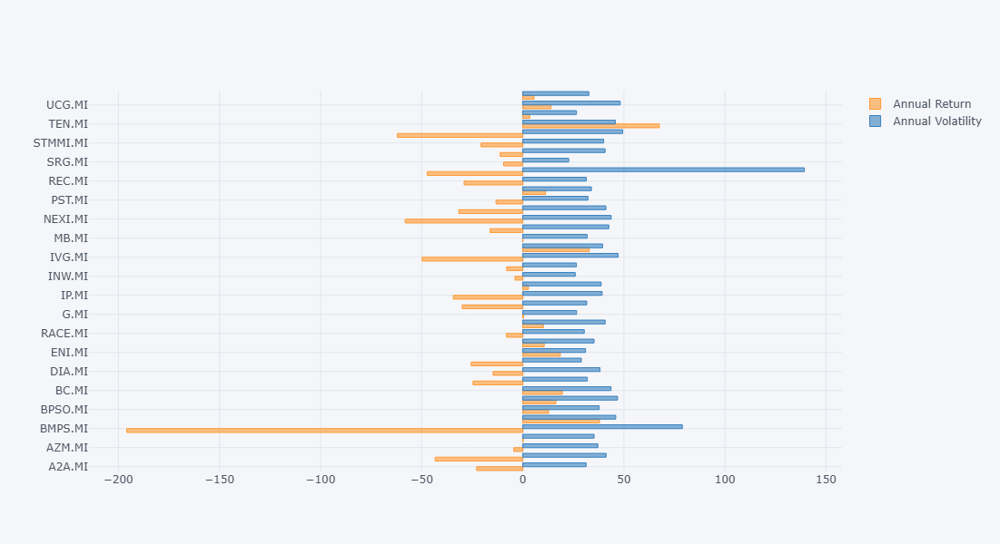

In [11]:
visualization = opt.return_visualization()
visualization

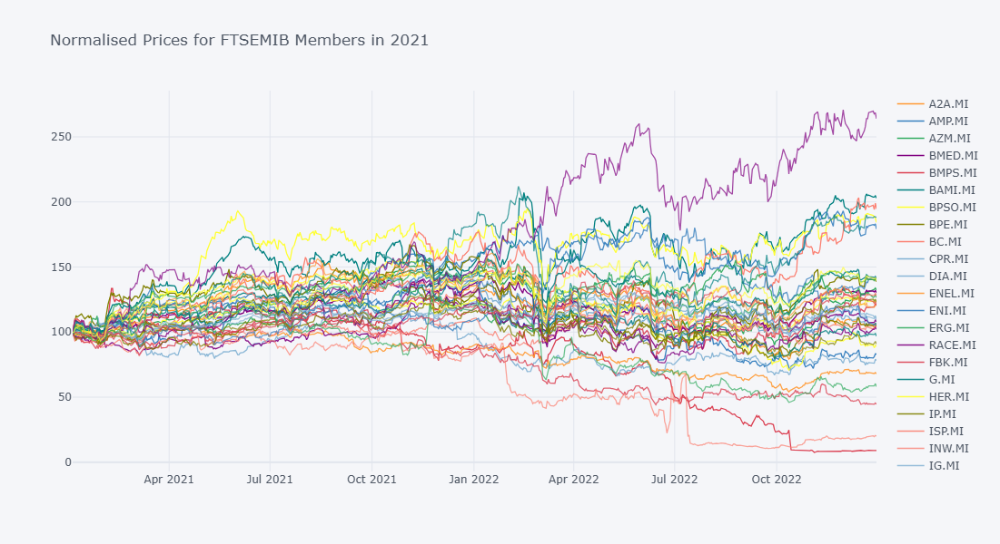

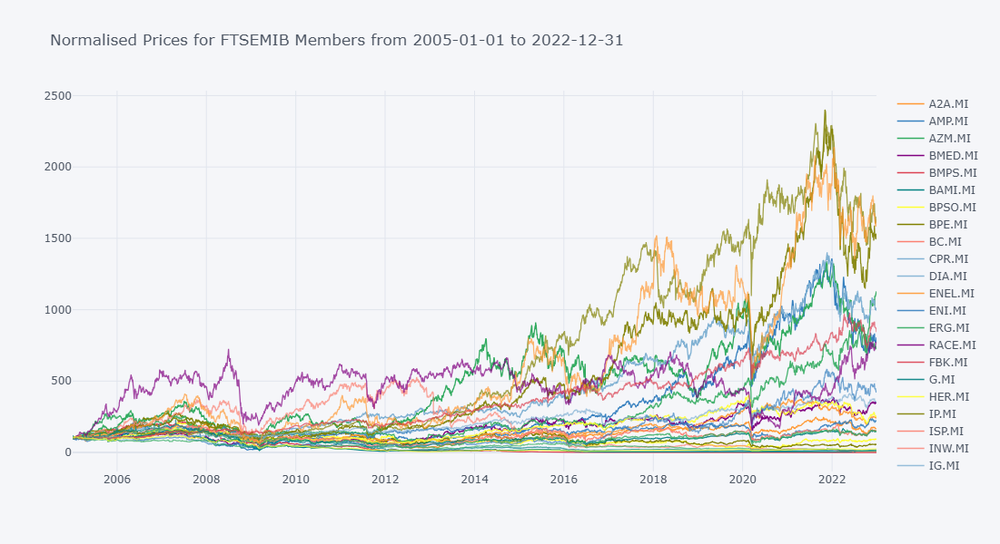

In [12]:
year = '2021'
hist_price = opt.normalised_price_visualization(year)

In [13]:
# Create a dataframe for analysis
temp = opt.portfolio_simulation()


100%|██████████| 100000/100000 [10:38<00:00, 156.65it/s]


In [14]:
temp.head(20)

,port_rets,port_vols,A2A.MI weight,AMP.MI weight,AZM.MI weight,BMED.MI weight,BMPS.MI weight,BAMI.MI weight,BPSO.MI weight,BPE.MI weight,...,SPM.MI weight,SRG.MI weight,STLAM.MI weight,STMMI.MI weight,TIT.MI weight,TEN.MI weight,TRN.MI weight,UCG.MI weight,UNI.MI weight,sharpe_ratio
0,-0.1275,0.2614,0.0205,0.0521,0.0401,0.0328,0.0086,0.0086,0.0032,0.0475,...,0.0093,0.0036,0.0520,0.0529,0.0443,0.0167,0.0053,0.0375,0.0241,-0.4879
1,-0.0780,0.2588,0.0064,0.0260,0.0018,0.0478,0.0136,0.0348,0.0164,0.0273,...,0.0104,0.0003,0.0429,0.0372,0.0383,0.0406,0.0039,0.0188,0.0061,-0.3014
2,-0.0872,0.2497,0.0432,0.0312,0.0166,0.0032,0.0156,0.0163,0.0365,0.0319,...,0.0081,0.0465,0.0404,0.0317,0.0436,0.0402,0.0093,0.0447,0.0270,-0.3491
3,-0.1103,0.2461,0.0423,0.0469,0.0167,0.0058,0.0119,0.0224,0.0428,0.0451,...,0.0126,0.0076,0.0256,0.0516,0.0127,0.0352,0.0399,0.0124,0.0382,-0.4482
4,-0.0959,0.2547,0.0180,0.0309,0.0310,0.0262,0.0044,0.0408,0.0157,0.0091,...,0.0439,0.0440,0.0309,0.0166,0.0171,0.0355,0.0439,0.0434,0.0381,-0.3763
5,-0.1845,0.2508,0.0348,0.0046,0.0088,0.0486,0.0328,0.0005,0.0055,0.0359,...,0.0272,0.0312,0.0267,0.0106,0.0391,0.0152,0.0013,0.0350,0.0096,-0.7356
6,-0.0681,0.2509,0.0369,0.0374,0.0359,0.0145,0.0006,0.0364,0.0168,0.0379,...,0.0318,0.0340,0.0358,0.0200,0.0197,0.0313,0.0255,0.0275,0.0312,-0.2716
7,-0.1617,0.2572,0.0518,0.0197,0.0219,0.0055,0.0336,0.0021,0.0271,0.0316,...,0.0046,0.0015,0.0560,0.0486,0.0405,0.0238,0.0101,0.0091,0.0146,-0.6289
8,-0.2038,0.2569,0.0297,0.0387,0.0357,0.0152,0.0517,0.0399,0.0300,0.0331,...,0.0463,0.0356,0.0088,0.0038,0.0348,0.0014,0.0317,0.0509,0.0311,-0.7933
9,-0.1377,0.2584,0.0183,0.0303,0.0216,0.0257,0.0443,0.0182,0.0453,0.0426,...,0.0194,0.0175,0.0366,0.0160,0.0438,0.0404,0.0202,0.0353,0.0355,-0.5331


In [15]:
# Get the max sharpe portfolio stats
temp.iloc[temp.sharpe_ratio.idxmax()]

port_rets          0.0039
port_vols          0.2512
A2A.MI weight      0.0094
AMP.MI weight      0.0012
AZM.MI weight      0.0195
BMED.MI weight     0.0491
BMPS.MI weight     0.0009
BAMI.MI weight     0.0065
BPSO.MI weight     0.0481
BPE.MI weight      0.0182
BC.MI weight       0.0559
CPR.MI weight      0.0227
DIA.MI weight      0.0475
ENEL.MI weight     0.0154
ENI.MI weight      0.0037
ERG.MI weight      0.0525
RACE.MI weight     0.0553
FBK.MI weight      0.0422
G.MI weight        0.0459
HER.MI weight      0.0004
IP.MI weight       0.0449
ISP.MI weight      0.0281
INW.MI weight      0.0270
IG.MI weight       0.0322
IVG.MI weight      0.0162
LDO.MI weight      0.0415
MB.MI weight       0.0176
MONC.MI weight     0.0333
NEXI.MI weight     0.0082
PIRC.MI weight     0.0402
PST.MI weight      0.0113
PRY.MI weight      0.0101
REC.MI weight      0.0014
SPM.MI weight      0.0073
SRG.MI weight      0.0139
STLAM.MI weight    0.0132
STMMI.MI weight    0.0195
TIT.MI weight      0.0032
TEN.MI weigh

In [16]:
# Verify the above result
temp.describe().T

,count,mean,std,min,25%,50%,75%,max
port_rets,100000.0,-0.1251,0.0363,-0.2781,-0.1507,-0.1251,-0.0993,0.0039
port_vols,100000.0,0.2526,0.0068,0.2237,0.2480,0.2525,0.2571,0.2891
A2A.MI weight,100000.0,0.0250,0.0144,0.0000,0.0127,0.0251,0.0370,0.0716
AMP.MI weight,100000.0,0.0250,0.0145,0.0000,0.0127,0.0250,0.0371,0.0692
AZM.MI weight,100000.0,0.0250,0.0144,0.0000,0.0126,0.0250,0.0370,0.0717
BMED.MI weight,100000.0,0.0249,0.0144,0.0000,0.0126,0.0248,0.0369,0.0698
BMPS.MI weight,100000.0,0.0250,0.0144,0.0000,0.0127,0.0251,0.0370,0.0675
BAMI.MI weight,100000.0,0.0250,0.0144,0.0000,0.0127,0.0251,0.0370,0.0675
BPSO.MI weight,100000.0,0.0250,0.0144,0.0000,0.0127,0.0250,0.0370,0.0718
BPE.MI weight,100000.0,0.0251,0.0144,0.0000,0.0128,0.0251,0.0370,0.0675


100%|██████████| 100000/100000 [10:10<00:00, 163.72it/s]


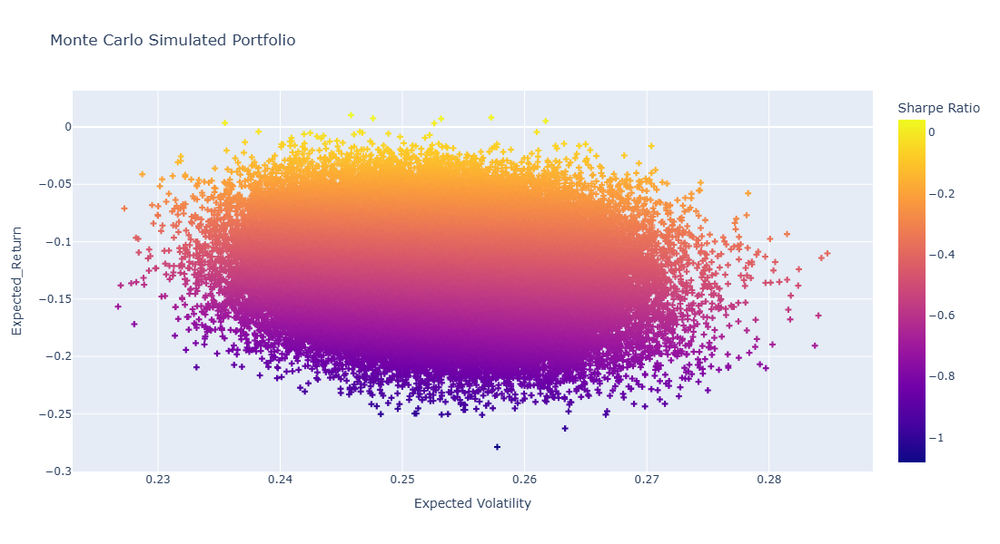

In [17]:
chart = opt.plot_simulated_portfolios()
chart

#### Lagrangian Optimization Results

In [39]:
opt.return_vol_dataframe()


,Annual Return,Annual Volatility
A2A.MI,-22.84,31.32
AMP.MI,-43.32,41.22
AZM.MI,-4.43,37.13
BMED.MI,0.20,35.26
BMPS.MI,-195.91,78.90
BAMI.MI,37.99,45.97
BPSO.MI,12.75,37.78
BPE.MI,16.36,46.86
BC.MI,19.57,43.65
CPR.MI,-24.59,31.91


In [20]:
lagrange = opt.constrained_optimiser(m=0.04)
lagrange

[['A2A.MI', 4.461349547270843],
 ['AMP.MI', -1.6726460798645981],
 ['AZM.MI', -3.918808662405615],
 ['BMED.MI', -2.6144181973424496],
 ['BMPS.MI', 1.9112800836640977],
 ['BAMI.MI', -2.2533045906546256],
 ['BPSO.MI', 7.8446343123119044],
 ['BPE.MI', -2.8005813290253347],
 ['BC.MI', -2.835617256813261],
 ['CPR.MI', 9.940057741454893],
 ['DIA.MI', 2.721480648321669],
 ['ENEL.MI', -8.244491019048095],
 ['ENI.MI', 17.117555222831825],
 ['ERG.MI', -1.8593986759685293],
 ['RACE.MI', 23.012228473627093],
 ['FBK.MI', -18.18767503783722],
 ['G.MI', 12.564194033836273],
 ['HER.MI', -5.986000699574978],
 ['IP.MI', -0.10806347137560235],
 ['ISP.MI', 6.899420726846095],
 ['INW.MI', 18.680508803058725],
 ['IG.MI', -4.136552231174639],
 ['IVG.MI', -4.758220111717209],
 ['LDO.MI', 15.96543940028826],
 ['MB.MI', 8.131119182266266],
 ['MONC.MI', -4.3973276879615835],
 ['NEXI.MI', 1.500874685998363],
 ['PIRC.MI', -0.12629289996544668],
 ['PST.MI', -5.168239686031006],
 ['PRY.MI', -2.8107799814133028],
 ['

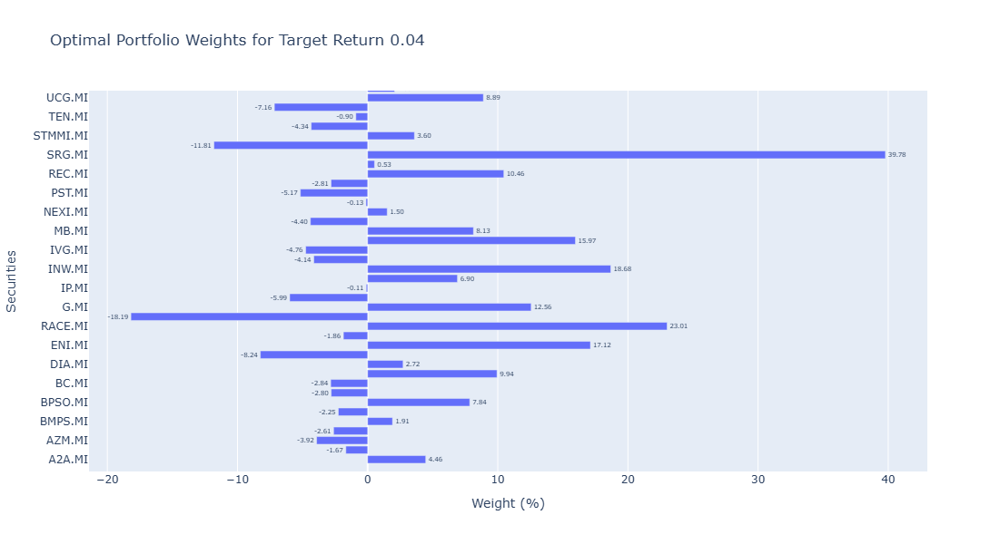

In [22]:
opt.constrained_optimizer_visuals(m=0.04)

## 4. Conclusions:

We have observed how to optimize weights in your portfolio with the typical Markowitz settings and using a Lagrangian approach with a set return constraint, displayed the relevant datapoints in useful charts. We can instead set a risk contraint (e.g. our portfolio cannot reach more than 10% annual volatility) and use a similar approach as the one used when setting the return constraint.

If you have any questions, please feel free to reach out to me!